In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory
'''
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        #print(os.path.join(dirname, filename))
        print('')
'''       
        
        

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

"\nimport os\nfor dirname, _, filenames in os.walk('/kaggle/input'):\n    for filename in filenames:\n        #print(os.path.join(dirname, filename))\n        print('')\n"

In [3]:
### Using Midas Model

!pip install torch torchvision opencv-python

In [4]:
## Using Midas to get depth from the Images

import os
import torch
import cv2
import numpy as np
import pandas as pd
import base64

def generate_depth_map(image, model, transform):
    img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB

    # Apply the transformation and remove any extra dimensions
    input_batch = transform(img_rgb).unsqueeze(0)  # Add batch dimension [1, 3, H, W]
    
    # Remove any extra dimensions accidentally added by the transformation (in case of [1, 1, 3, H, W])
    input_batch = input_batch.squeeze(1)  # Ensure shape is [1, 3, H, W]
    
    # Ensure input is on the correct device
    input_batch = input_batch.to(next(model.parameters()).device)

    # Debugging: Print the input tensor shape to verify it is correct
    #print(f"Input batch shape (after squeezing): {input_batch.shape}")

    with torch.no_grad():
        prediction = model(input_batch)  # Generate depth prediction

    # Debugging: Print prediction shape
    #print(f"Prediction shape: {prediction.shape}")

    # Resize prediction to the original image size
    prediction = torch.nn.functional.interpolate(
        prediction.unsqueeze(1),  # Add channel dimension
        size=image.shape[:2],  # Resize to match the original image size
        mode="bicubic",
        align_corners=False,
    ).squeeze(1)  # Remove the added channel dimension

    # Convert to numpy and normalize
    depth_map = prediction.cpu().numpy()
    depth_map = (depth_map - depth_map.min()) / (depth_map.max() - depth_map.min())  # Normalize

    return depth_map


In [5]:
def encode_image(image):
    # If the image has only one channel (grayscale), ensure it's 2D
    if len(image.shape) == 3 and image.shape[0] == 1:
        image = image.squeeze(0)  # Remove the extra dimension
    
    # Normalize the image (depth map) to uint8
    if image.dtype != np.uint8:
        image = (255 * (image / np.max(image))).astype(np.uint8)

    # Ensure it is single-channel grayscale for OpenCV
    if len(image.shape) == 2:
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)

    # Encode as PNG
    retval, buffer = cv2.imencode('.png', image)
    
    # Return base64 encoded string
    return base64.b64encode(buffer).decode('utf-8')


In [6]:
# Initialize MiDaS model - MiDaS small model for quicker execution
model_type = "MiDaS_small"  # MiDaS small version
midas = torch.hub.load("intel-isl/MiDaS", model_type)
midas.eval()

# Load transforms for the model
transforms = torch.hub.load("intel-isl/MiDaS", "transforms")
transform = transforms.small_transform  # For MiDaS_small

/opt/conda/lib/python3.10/site-packages/torch/hub.py:295: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/intel-isl/MiDaS/zipball/master" to /root/.cache/torch/hub/master.zip


Loading weights:  None


/opt/conda/lib/python3.10/site-packages/torch/hub.py:295: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/rwightman/gen-efficientnet-pytorch/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_lite3-b733e338.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_lite3-b733e338.pth
Downloading: "https://github.

In [8]:
# Define input folder path
input_folder = "/kaggle/input/flicker8k-dataset/Flickr8k_Dataset/Flicker8k_Dataset"
csv_file_path = "final_data.csv"

# Create a list to hold data for CSV
data = []

In [28]:
# Process all images in the input folder
for filename in os.listdir(input_folder):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        # Read the image
        image_path = os.path.join(input_folder, filename)
        image = cv2.imread(image_path)

        # Generate depth map
        depth_map = generate_depth_map(image, midas, transform)

        # Normalize the depth map for storing
        depth_map = (255 * depth_map).astype(np.uint8)

        # Encode image and depth map as base64 strings
        encoded_image = encode_image(image)         # Original image as base64
        encoded_depth_map = encode_image(depth_map) # Depth map as base64

        # Append to data list
        data.append([encoded_image, encoded_depth_map])

        print(f"Processed {filename}")


Processed 3226254560_2f8ac147ea.jpg
Processed 214543992_ce6c0d9f9b.jpg
Processed 2366643786_9c9a830db8.jpg
Processed 3368819708_0bfa0808f8.jpg
Processed 2190227737_6e0bde2623.jpg
Processed 2752809449_632cd991b3.jpg
Processed 3097776588_312932e438.jpg
Processed 1206506157_c7956accd5.jpg
Processed 1319634306_816f21677f.jpg
Processed 2465218087_fca77998c6.jpg
Processed 3351493005_6e5030f596.jpg
Processed 2949337912_beba55698b.jpg
Processed 534886684_a6c9f40fa1.jpg
Processed 3543600125_223747ef4c.jpg
Processed 2174206711_11cb712a8d.jpg
Processed 280706862_14c30d734a.jpg
Processed 2100735137_05c6079537.jpg
Processed 3131632154_098f86f4cb.jpg
Processed 2236016316_f476cbbf06.jpg
Processed 3335375223_b4da8df523.jpg
Processed 929679367_ff8c7df2ee.jpg
Processed 241347214_5f19e7998c.jpg
Processed 2998024845_1529c11694.jpg
Processed 1317292658_ba29330a0b.jpg
Processed 2521938720_911ac092f7.jpg
Processed 3426933951_2302a941d8.jpg
Processed 2410399168_1462c422d4.jpg
Processed 2587106431_1cc0e719c6.j

In [31]:
# Create a DataFrame and save to CSV
df = pd.DataFrame(data, columns=['Image', 'Depth_Map'])
df.to_csv(csv_file_path, index=False)

print(f"CSV file with images and depth maps saved at {csv_file_path}.")

CSV file with images and depth maps saved at final_data.csv.


In [30]:
df  

,Image,Depth_Map
0,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...
1,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...
2,iVBORw0KGgoAAAANSUhEUgAAAfQAAAF3CAIAAADckC6rAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAF3CAIAAADckC6rAA...
3,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...
4,iVBORw0KGgoAAAANSUhEUgAAARkAAAH0CAIAAACGqM4cAA...,iVBORw0KGgoAAAANSUhEUgAAARkAAAH0CAIAAACGqM4cAA...
...,...,...
8996,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFOCAIAAAD/5XjOAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFOCAIAAAD/5XjOAA...
8997,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFjCAIAAABE124mAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFjCAIAAABE124mAA...
8998,iVBORw0KGgoAAAANSUhEUgAAAfQAAAF3CAIAAADckC6rAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAF3CAIAAADckC6rAA...
8999,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...


In [4]:
import pandas as pd
depth_data = pd.read_csv('/kaggle/input/final-data/final_data.csv')
depth_data

,Image,Depth_Map
0,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...
1,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...
2,iVBORw0KGgoAAAANSUhEUgAAAfQAAAF3CAIAAADckC6rAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAF3CAIAAADckC6rAA...
3,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...
4,iVBORw0KGgoAAAANSUhEUgAAARkAAAH0CAIAAACGqM4cAA...,iVBORw0KGgoAAAANSUhEUgAAARkAAAH0CAIAAACGqM4cAA...
...,...,...
8996,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFOCAIAAAD/5XjOAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFOCAIAAAD/5XjOAA...
8997,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFjCAIAAABE124mAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFjCAIAAABE124mAA...
8998,iVBORw0KGgoAAAANSUhEUgAAAfQAAAF3CAIAAADckC6rAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAF3CAIAAADckC6rAA...
8999,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...,iVBORw0KGgoAAAANSUhEUgAAAfQAAAFNCAIAAAB5cQpgAA...


**EXPERIMENT 1** : Depth from Image +  Caption = ""  

In [9]:
!pip install transformers diffusers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 37.8 MB/s eta 0:00:0000:0100:01


In [10]:
!pip install --upgrade diffusers transformers


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.1/44.1 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.0/10.0 MB 75.1 MB/s eta 0:00:00:00:01:01
  Attempting uninstall: transformers
    Found existing installation: transformers 4.45.1
    Uninstalling transformers-4.45.1:
      Successfully uninstalled transformers-4.45.1


In [11]:
import torch
from diffusers import StableDiffusionDepth2ImgPipeline
from transformers import AutoTokenizer
import numpy as np
from PIL import Image
import cv2
from skimage.metrics import structural_similarity as ssim

# Initialize Hugging Face diffusion model (pre-trained depth2img model)
from diffusers import StableDiffusionPipeline
test_pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1-base")


The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

model_index.json:   0%|          | 0.00/543 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/613 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/346 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/911 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/553 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [12]:
from diffusers import StableDiffusionPipeline
import torch
import numpy as np
from PIL import Image
import torch.nn.functional as F
from IPython.display import display

# Preprocessing function for depth maps
def preprocess_depth_map(depth_map, target_height, target_width, device):
    # Convert the depth map from NumPy array to a PyTorch tensor
    if isinstance(depth_map, np.ndarray):
        depth_map = torch.tensor(depth_map)
    
    # Ensure the depth map is in the right format (N, C, H, W)
    if depth_map.ndimension() == 2:
        depth_map = depth_map.unsqueeze(0).unsqueeze(0)  # Adding batch and channel dimensions
    elif depth_map.ndimension() == 3:
        depth_map = depth_map.unsqueeze(1)  # Adding channel dimension
    
    depth_map_tensor = depth_map.float()
    
    # Resize the tensor to the target size
    if depth_map_tensor.shape[2] != target_height or depth_map_tensor.shape[3] != target_width:
        depth_map_tensor = F.interpolate(depth_map_tensor, size=(target_height, target_width), mode="bicubic", align_corners=False)
    
    # Ensure it is on the correct device
    depth_map_tensor = depth_map_tensor.to(device)
    
    return depth_map_tensor


In [13]:
from PIL import Image
import numpy as np

# Stable Diffusion image reconstruction function
def stable_diffusion_image_reconstruct(prompt, depth_map, device):
    # Define target dimensions directly
    target_height, target_width = 63, 46
    
    # Preprocess the depth map to match the model's input expectations
    depth_image_tensor = preprocess_depth_map(depth_map, target_height, target_width, device)
    blank_image = np.zeros((depth_map.shape[1], depth_map.shape[2], 3), dtype=np.float32)  # Adjusted the dimensions
    blank_image_pil = Image.fromarray((blank_image * 255).astype(np.uint8))
    
    generated_image = pipe(prompt=prompt, image=blank_image_pil, depth_map=depth_image_tensor).images[0]
    
    return generated_image

In [20]:
from skimage.metrics import structural_similarity as ssim
import cv2
import numpy as np
from PIL import Image

def calculate_ssim(original_image, generated_image):
    # Convert numpy arrays to PIL images if necessary
    if isinstance(original_image, np.ndarray):
        original_image = Image.fromarray((original_image * 255).astype(np.uint8)) if original_image.max() <= 1 else Image.fromarray(original_image)
    
    if isinstance(generated_image, np.ndarray):
        generated_image = Image.fromarray((generated_image * 255).astype(np.uint8)) if generated_image.max() <= 1 else Image.fromarray(generated_image)

    # Resize generated image if dimensions don't match
    if original_image.size != generated_image.size:
        generated_image = generated_image.resize(original_image.size)

    # Convert images to grayscale
    original_gray = cv2.cvtColor(np.array(original_image), cv2.COLOR_RGB2GRAY)
    generated_gray = cv2.cvtColor(np.array(generated_image), cv2.COLOR_RGB2GRAY)
    
    # Compute SSIM
    try:
        ssim_score, _ = ssim(original_gray, generated_gray, full=True)
    except ValueError as ve:
        raise ValueError(f"SSIM computation error: {ve}. Ensure both images are 2D arrays of the same dimensions.")
    
    return ssim_score



In [7]:
########### For Demonstration purposes we will be doing on ony a set of 4-5 images and take the SSIM

## Depth map code 

depth_maps = []
images = []

for x in range(4):
    image_path = input("Enter the image path    ")
    image = cv2.imread(image_path)
    images.append(image)

    # Generate depth map
    depth_map = generate_depth_map(image, midas, transform)
    depth_maps.append(depth_map)


Enter the image path     /kaggle/input/flicker8k-dataset/Flickr8k_Dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg
Enter the image path     /kaggle/input/flicker8k-dataset/Flickr8k_Dataset/Flicker8k_Dataset/1001773457_577c3a7d70.jpg
Enter the image path     /kaggle/input/flicker8k-dataset/Flickr8k_Dataset/Flicker8k_Dataset/1002674143_1b742ab4b8.jpg
Enter the image path     /kaggle/input/flicker8k-dataset/Flickr8k_Dataset/Flicker8k_Dataset/1003163366_44323f5815.jpg


In [8]:
print(depth_maps)

[array([[[0.01314991, 0.01332032, 0.01359229, ..., 0.61894536,
         0.5584297 , 0.52057356],
        [0.01356494, 0.01341346, 0.01317024, ..., 0.6337951 ,
         0.5873397 , 0.55827075],
        [0.01422126, 0.01355611, 0.01249073, ..., 0.65751857,
         0.63353866, 0.6185162 ],
        ...,
        [0.38612118, 0.38650668, 0.3871079 , ..., 0.99470484,
         0.9914175 , 0.9893079 ],
        [0.38176793, 0.38208738, 0.3825913 , ..., 0.99307853,
         0.9837023 , 0.97777367],
        [0.37903774, 0.37931347, 0.37975264, ..., 0.992051  ,
         0.97887236, 0.9705588 ]]], dtype=float32), array([[[1.4984375e-01, 1.4727901e-01, 1.4318699e-01, ...,
         2.4481216e-03, 9.4018958e-04, 0.0000000e+00],
        [1.4890641e-01, 1.4752385e-01, 1.4531572e-01, ...,
         2.5367201e-03, 1.2954674e-03, 5.2236306e-04],
        [1.4740495e-01, 1.4790879e-01, 1.4870682e-01, ...,
         2.6825024e-03, 1.8688255e-03, 1.3636223e-03],
        ...,
        [7.8557068e-01, 7.8558326e-01

In [17]:
print(depth_maps[0])

[[[0.01314991 0.01332032 0.01359229 ... 0.61894536 0.5584297  0.52057356]
  [0.01356494 0.01341346 0.01317024 ... 0.6337951  0.5873397  0.55827075]
  [0.01422126 0.01355611 0.01249073 ... 0.65751857 0.63353866 0.6185162 ]
  ...
  [0.38612118 0.38650668 0.3871079  ... 0.99470484 0.9914175  0.9893079 ]
  [0.38176793 0.38208738 0.3825913  ... 0.99307853 0.9837023  0.97777367]
  [0.37903774 0.37931347 0.37975264 ... 0.992051   0.97887236 0.9705588 ]]]


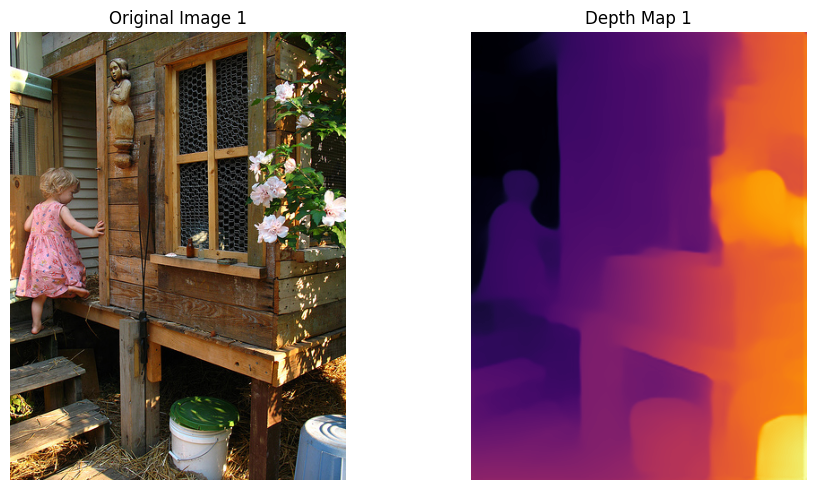

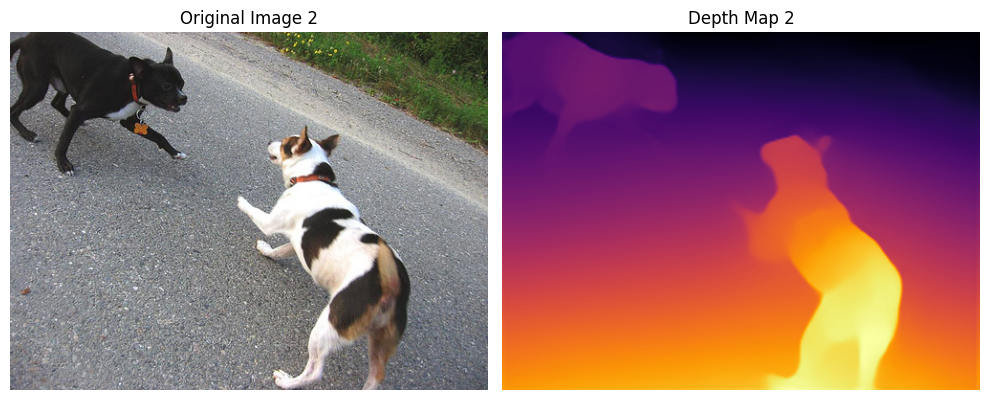

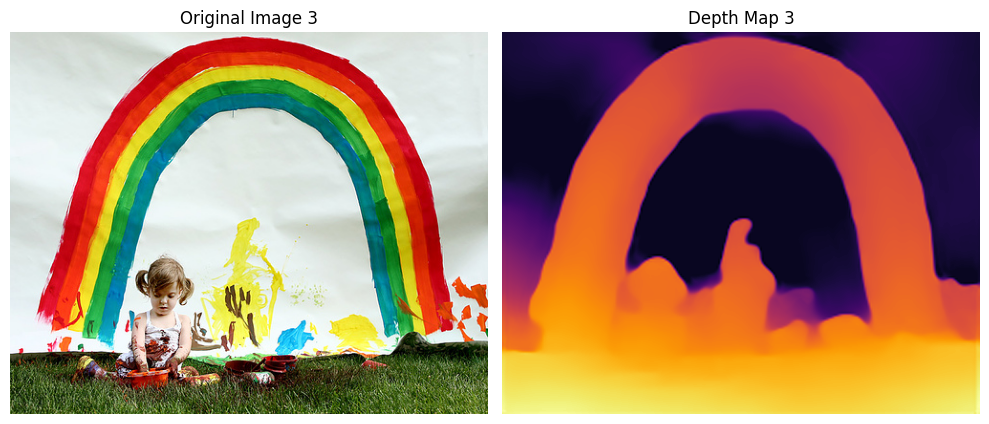

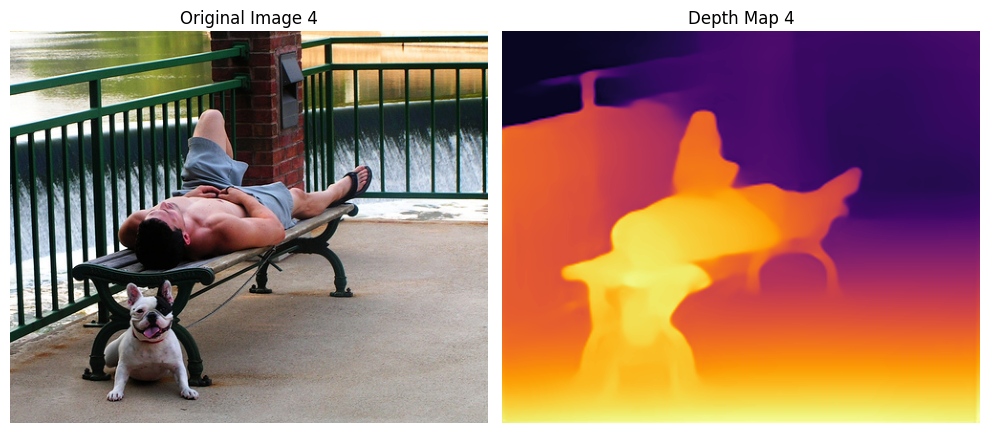

In [10]:
# Visualize images and depth maps
for idx, (image, depth_map) in enumerate(zip(images, depth_maps)):
    plt.figure(figsize=(10, 5))
    
    # Original Image
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for visualization
    plt.title(f"Original Image {idx + 1}")
    plt.axis("off")
    
    # Depth Map
    plt.subplot(1, 2, 2)
    depth_map_squeezed = np.squeeze(depth_map)  # Remove the extra dimension
    plt.imshow(depth_map_squeezed, cmap='inferno')  # Use a colormap for better depth perception
    plt.title(f"Depth Map {idx + 1}")
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()


In [18]:
from diffusers import StableDiffusionPipeline
import torch
import numpy as np
from PIL import Image
import torch.nn.functional as F
from IPython.display import display

# Load Stable Diffusion model (ensure depth estimator model if necessary)
pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2")
device = "cuda" if torch.cuda.is_available() else "cpu"
pipe.to(device)  # Move the pipeline to the correct device



model_index.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/345 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/909 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/611 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.31.0",
  "_name_or_path": "stabilityai/stable-diffusion-2",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": false,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "DDIMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

  0%|          | 0/50 [00:00<?, ?it/s]

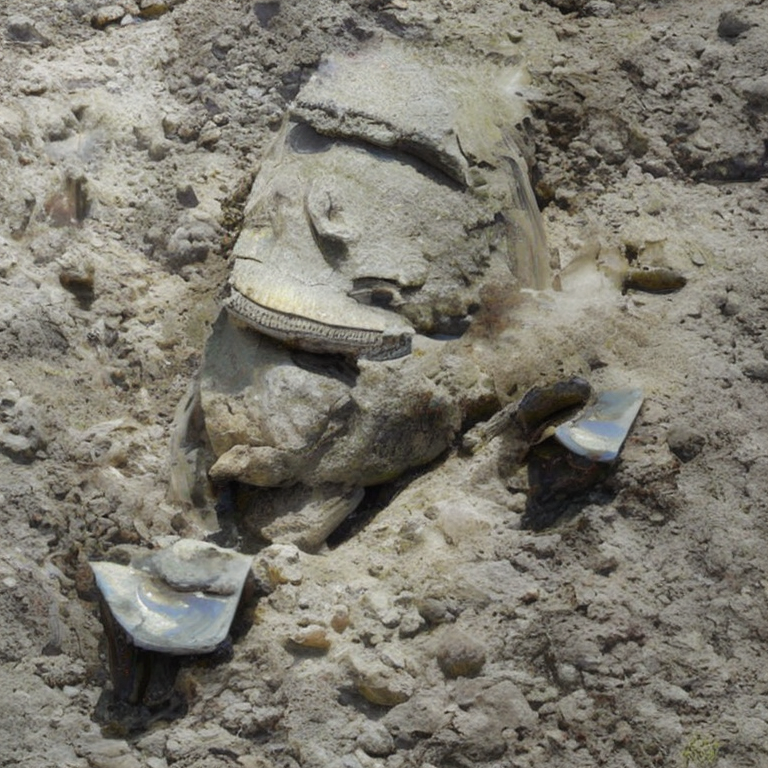

0.05771668446082805


  0%|          | 0/50 [00:00<?, ?it/s]

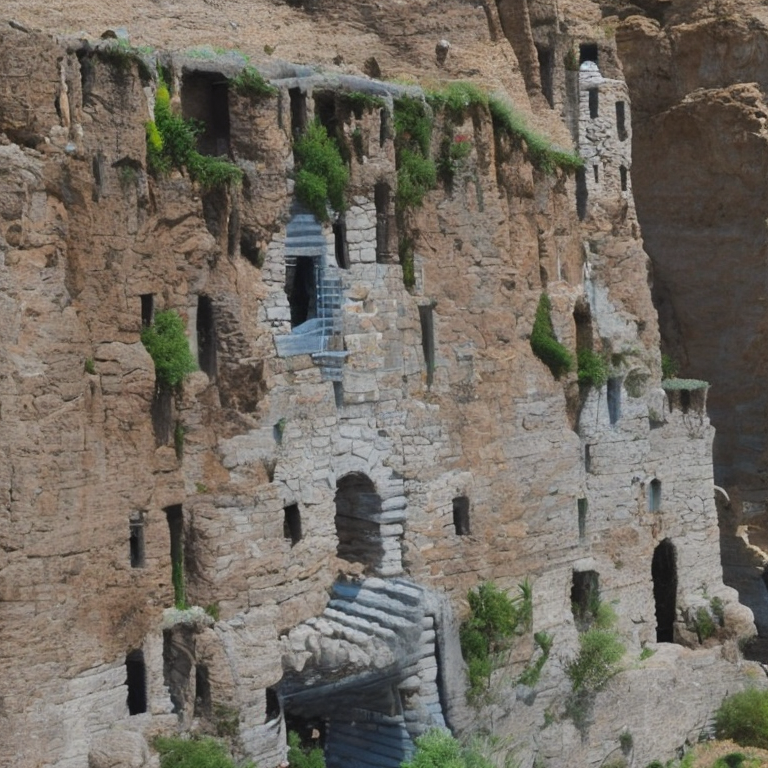

0.09915615048122582


  0%|          | 0/50 [00:00<?, ?it/s]

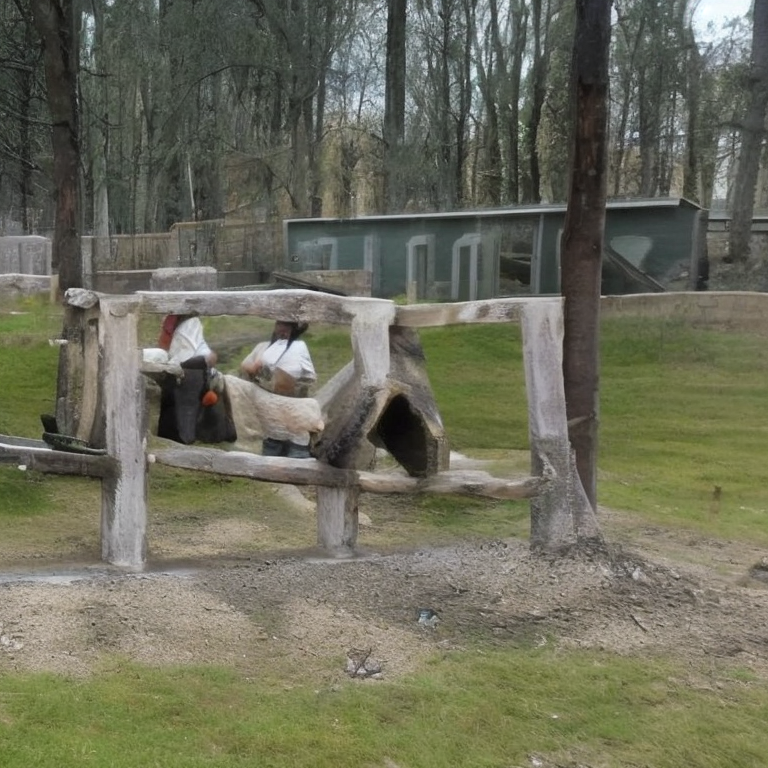

0.1556145813014494


  0%|          | 0/50 [00:00<?, ?it/s]

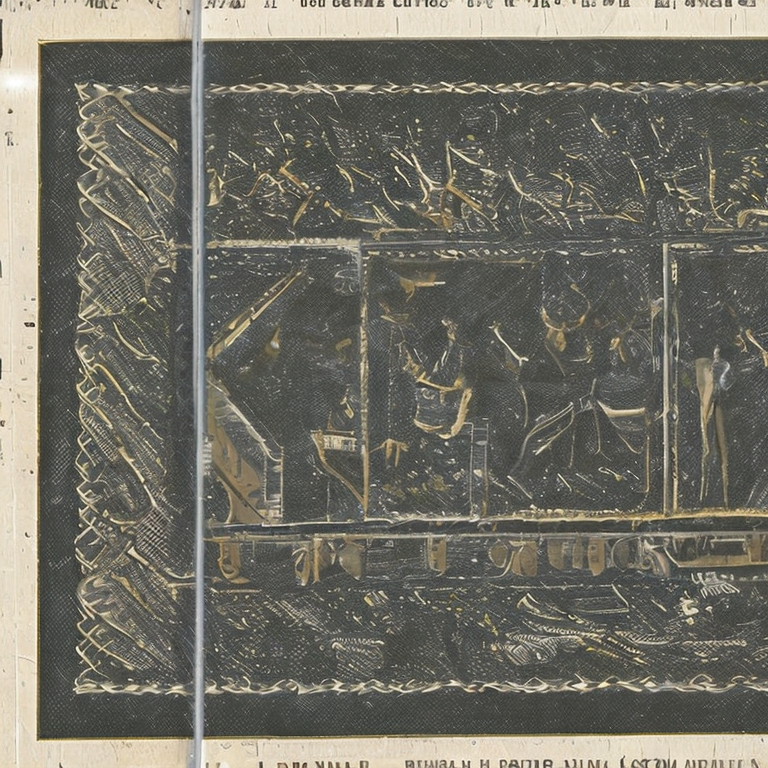

0.10084469064053306
[<function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>]


In [21]:
# Example depth map (replace with actual depth map data)
#depth_map = np.random.rand(1, 500, 375)  # Example depth map in NumPy array format

depth_map = depth_maps[0]

# Example text prompt
prompt = ""
ssim_avg = []

for x in range(len(depth_maps)):
    depth_map = depth_maps[x]

    # Generate image using depth map (you might need to adjust how depth is fed into the model)
    generated_image = stable_diffusion_image_reconstruct(prompt, depth_map, device)

    # Display the image inline in the Kaggle notebook
    display(generated_image)

    ssim_123 = calculate_ssim(images[x], generated_image)
    print(ssim_123)
    
    ssim_avg.append(ssim)
    
print(ssim_avg)    
    

  0%|          | 0/50 [00:00<?, ?it/s]

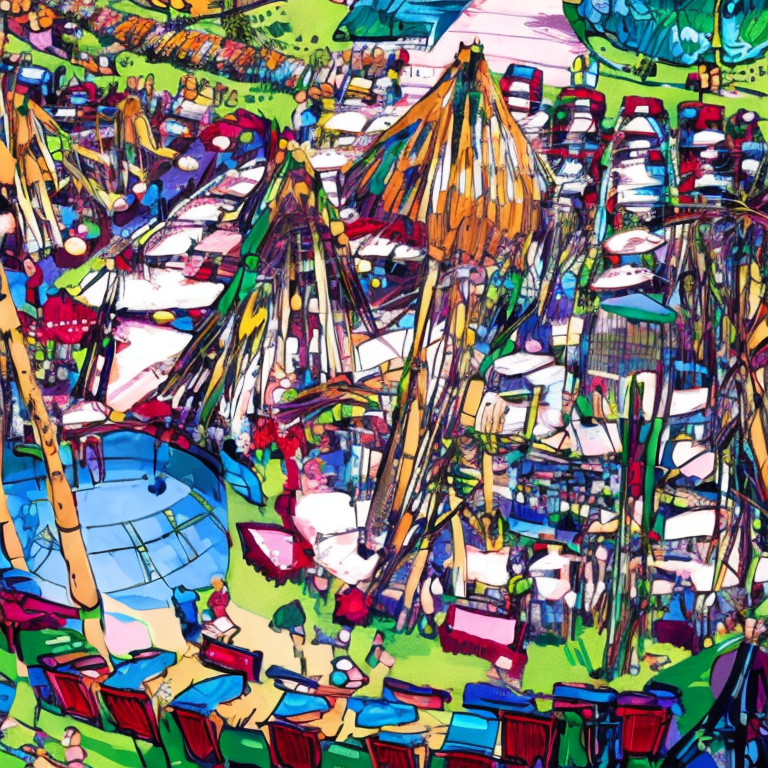

0.024036124422159796


  0%|          | 0/50 [00:00<?, ?it/s]

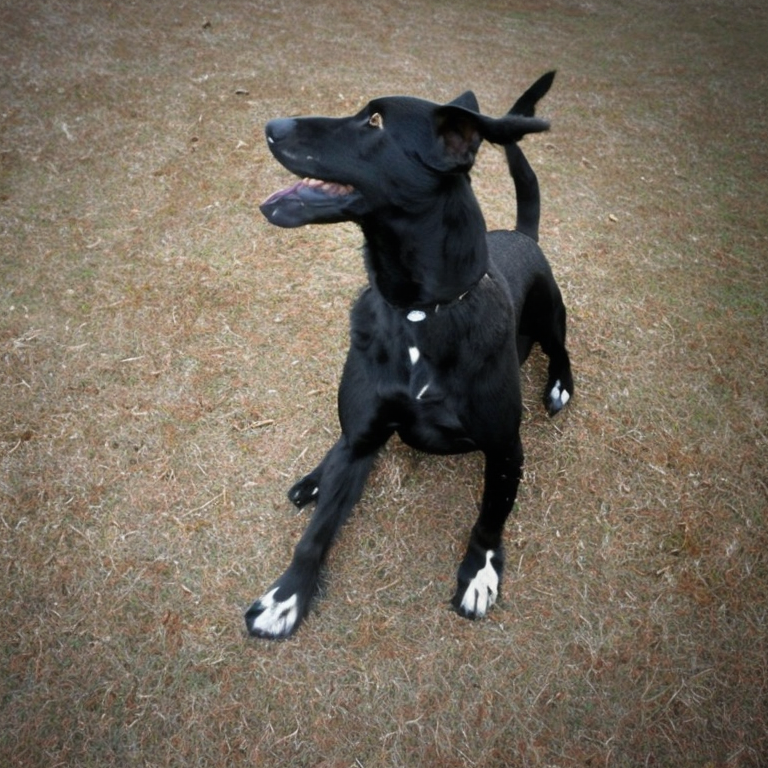

0.110980953424545


  0%|          | 0/50 [00:00<?, ?it/s]

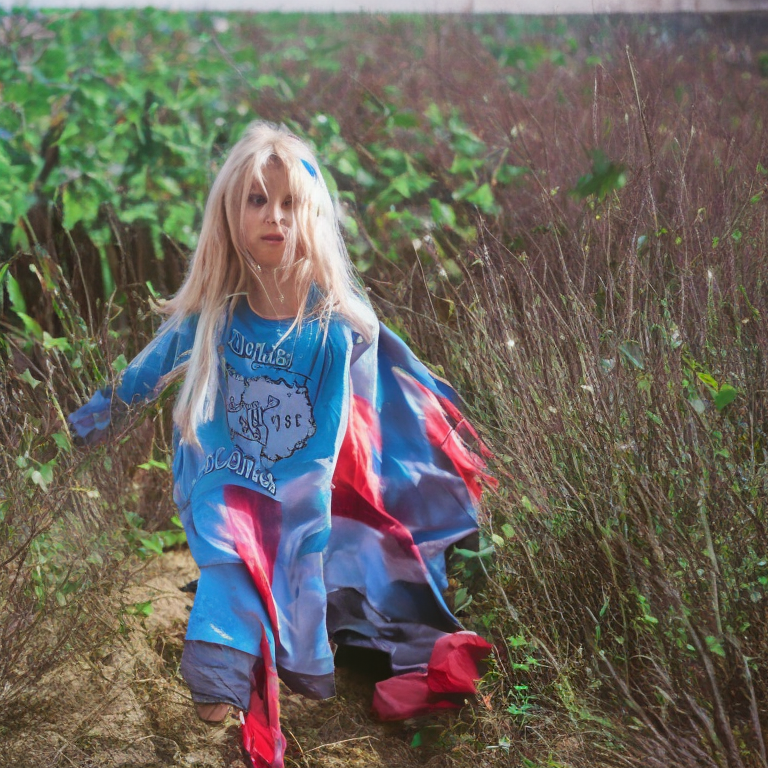

0.13049518173528005


  0%|          | 0/50 [00:00<?, ?it/s]

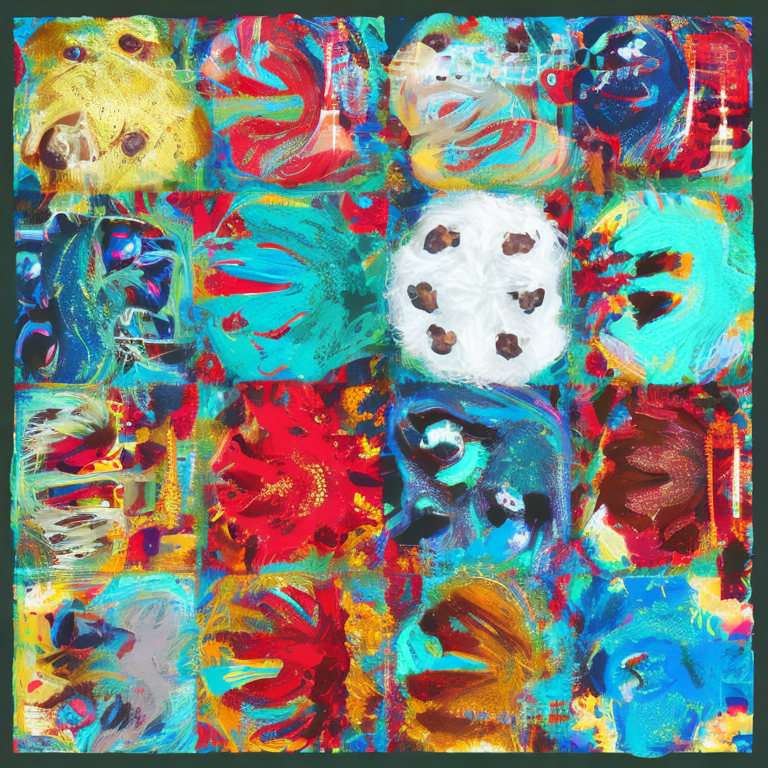

0.0824154535496239
[<function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>]


In [22]:
depth_map = depth_maps[0]

# Example text prompt
prompts = ['girl','dog', 'girl', 'dog']
ssim_avg = []

for x in range(len(depth_maps)):
    depth_map = depth_maps[x]
    prompt = prompts[x]

    # Generate image using depth map (you might need to adjust how depth is fed into the model)
    generated_image = stable_diffusion_image_reconstruct(prompt, depth_map, device)

    # Display the image inline in the Kaggle notebook
    display(generated_image)

    ssim_123 = calculate_ssim(images[x], generated_image)
    print(ssim_123)
    
    ssim_avg.append(ssim)
    
print(ssim_avg)    

  0%|          | 0/50 [00:00<?, ?it/s]

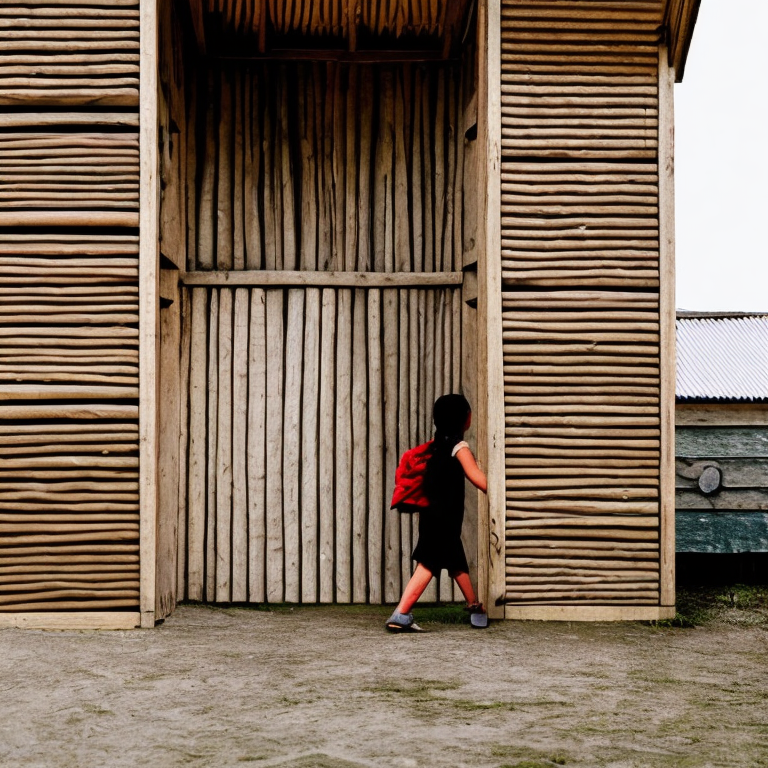

0.034382969495724974


  0%|          | 0/50 [00:00<?, ?it/s]

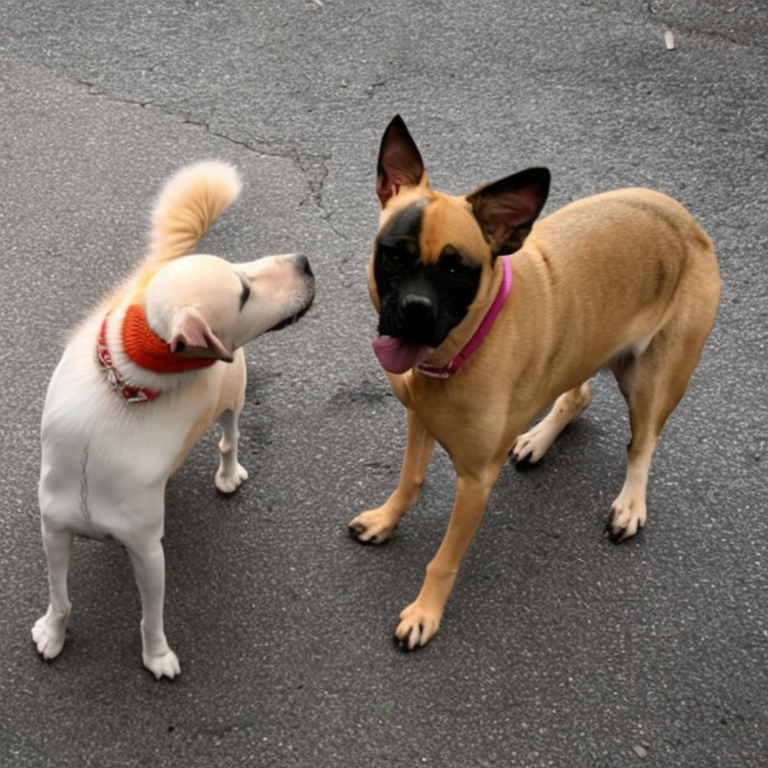

0.10833024923110918


  0%|          | 0/50 [00:00<?, ?it/s]

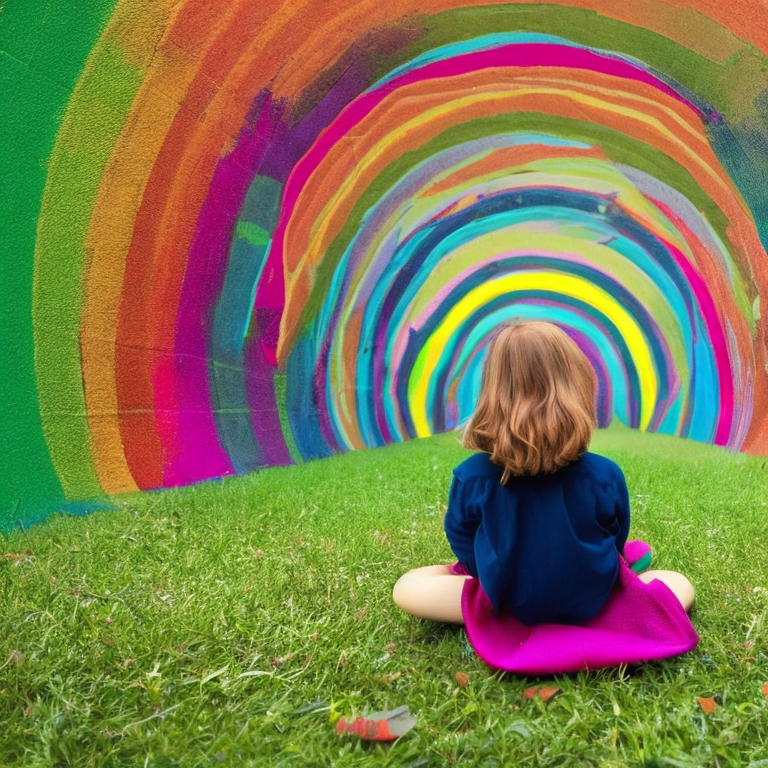

0.17411337917947342


  0%|          | 0/50 [00:00<?, ?it/s]

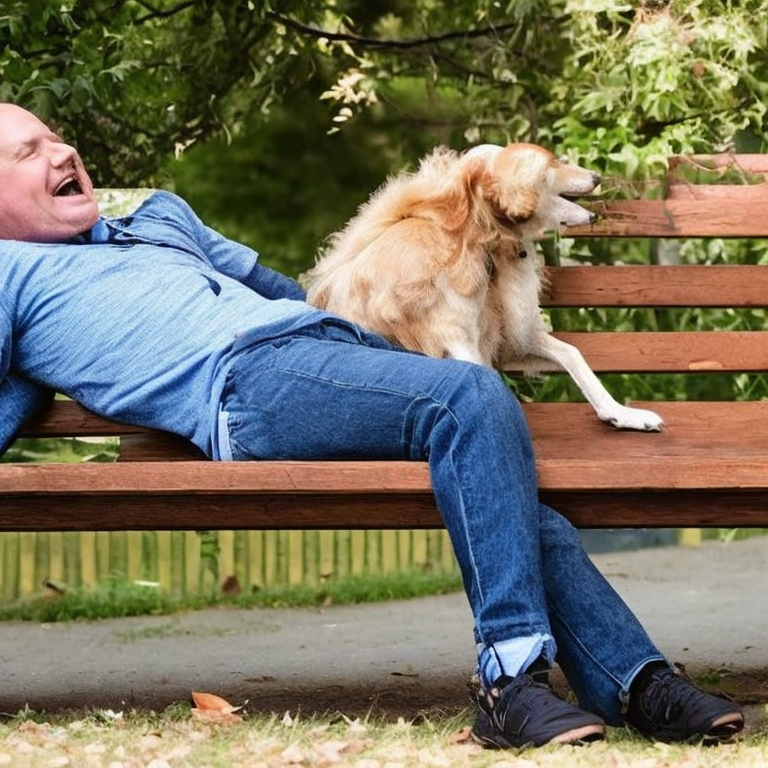

0.1068325294495743
[<function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>, <function structural_similarity at 0x7ae5a6e8b5b0>]


In [26]:
depth_map = depth_maps[0]

# Example text prompt
prompts = ['a girl going into a wooden building', 'two dogs staring at each other on a street', 'a young girl sitting in the grass in front of a colorful painted tunnel', 'a man lying down on a bench with his dog nearby']
ssim_avg = []

for x in range(len(depth_maps)):
    depth_map = depth_maps[x]
    prompt = prompts[x]

    # Generate image using depth map (you might need to adjust how depth is fed into the model)
    generated_image = stable_diffusion_image_reconstruct(prompt, depth_map, device)

    # Display the image inline in the Kaggle notebook
    display(generated_image)

    ssim_123 = calculate_ssim(images[x], generated_image)
    print(ssim_123)
    
    ssim_avg.append(ssim)
    
print(ssim_avg)    

In [2]:
!pip install diffusers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 31.6 MB/s eta 0:00:00a 0:00:01


In [ ]:
import torch
from diffusers import StableDiffusionPipeline
import numpy as np
from PIL import Image
import torch.nn.functional as F
from IPython.display import display

# Initialize Hugging Face diffusion model (pre-trained depth2img model)
test_pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1-base")

# Load EEG embeddings from the .npy file
eeg_embeddings_path = "/kaggle/input/modiied-eeg/modified_eeg_embeddings.npy"
eeg_embeddings = np.load(eeg_embeddings_path)  # Load the EEG embeddings

# Convert EEG embeddings to a tensor and move to device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
eeg_embeddings_tensor = torch.tensor(eeg_embeddings).to(device)
eeg_embeddings_tensor = eeg_embeddings_tensor.unsqueeze(1)  # Shape becomes [batch_size, 1, embed_dim]

# Preprocessing function for depth maps
def preprocess_depth_map(depth_map, target_height, target_width, device):
    if isinstance(depth_map, np.ndarray):
        depth_map = torch.tensor(depth_map).to(device)  # Move to GPU
    
    if depth_map.ndimension() == 2:
        depth_map = depth_map.unsqueeze(0).unsqueeze(0)  # Adding batch and channel dimensions
    elif depth_map.ndimension() == 3:
        depth_map = depth_map.unsqueeze(1)  # Adding channel dimension
    
    depth_map_tensor = depth_map.float().to(device)  # Ensure the depth map is on the correct device
    
    if depth_map_tensor.shape[2] != target_height or depth_map_tensor.shape[3] != target_width:
        depth_map_tensor = F.interpolate(depth_map_tensor, size=(target_height, target_width), mode="bicubic", align_corners=False)
    
    return depth_map_tensor

# Stable Diffusion image reconstruction function with EEG embeddings
def stable_diffusion_image_reconstruct(eeg_embeddings, depth_map, device):
    target_height, target_width = 64, 64  # Set to appropriate dimensions based on your model
    
    # Preprocess the depth map
    depth_image_tensor = preprocess_depth_map(depth_map, target_height, target_width, device)
    
    # Create an initial blank image to provide the model
    blank_image = np.zeros((depth_map.shape[1], depth_map.shape[2], 3), dtype=np.float32)  # Adjust dimensions as necessary
    blank_image_pil = Image.fromarray((blank_image * 255).astype(np.uint8))
    
    # Use EEG embeddings as the conditioning input (prompt_embeds)
    generated_image = test_pipe(
        prompt_embeds=eeg_embeddings_tensor,  # Use EEG embeddings directly
        image=blank_image_pil,
        depth_map=depth_image_tensor,
        guidance_scale=7.5,
        num_inference_steps=50
    ).images[0]
    
    return generated_image

# Example depth maps (replace with actual depth map data)
depth_maps = [np.random.rand(1, 500, 375)]  # Replace with actual depth data

# Process the EEG embeddings and depth data for image reconstruction
for x in range(len(depth_maps)):
    depth_map = depth_maps[x]

    # Generate image using EEG embeddings and depth map
    generated_image = stable_diffusion_image_reconstruct(eeg_embeddings_tensor, depth_map, device)

    # Display the image inline in the notebook
    display(generated_image)


The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

model_index.json:   0%|          | 0.00/543 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/613 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/346 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/911 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/553 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1617: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be deprecated in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
